In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns


In [8]:
df = pd.read_csv('/Users/mjs/Desktop/Dev/Segmentation_Banking_2022/Credit-Card-Segmentation/data/transactions_dropped_150_NaN.csv')
df_num = df.drop(columns = ['customer_id'])

In [9]:
df_num.head()

,Unnamed: 0,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc
0,0,9.298409,107.60,0.000000,0.00,0.909091,107.6,0.909091,0.000000,0.818182,0.000000,0,10,1000.0,11,89.868853,89.711672,0.428571
1,1,52.666422,150.30,0.000000,0.00,1.000000,150.3,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,6,54.722514,82.955180,0.000000
2,2,1360.795674,0.00,462.861443,0.00,1.000000,0.0,0.000000,0.000000,0.000000,0.272727,6,0,1500.0,11,303.031979,443.781316,0.000000
3,3,2021.641161,363.18,0.000000,363.18,1.000000,0.0,1.000000,1.000000,0.000000,0.000000,0,13,2000.0,12,704.240770,795.859808,0.000000
4,4,22.322374,95.00,1162.045833,95.00,0.363636,0.0,0.083333,0.083333,0.000000,0.166667,3,1,2500.0,12,4094.261427,40.142262,0.000000


In [4]:
df_num.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8334 entries, 0 to 8333
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Unnamed: 0                        8334 non-null   int64  
 1   balance_account                   8334 non-null   float64
 2   purchases_amount                  8334 non-null   float64
 3   paid_advance                      8334 non-null   float64
 4   full_purchases                    8334 non-null   float64
 5   balance_frequency_update          8334 non-null   float64
 6   installments                      8334 non-null   float64
 7   purchases_frequency               8334 non-null   float64
 8   full_purchases_frequency          8334 non-null   float64
 9   purchases_installments_frequency  8334 non-null   float64
 10  cash_advance_frequency            8334 non-null   float64
 11  nr_cash_advances                  8334 non-null   int64  
 12  nr_pur

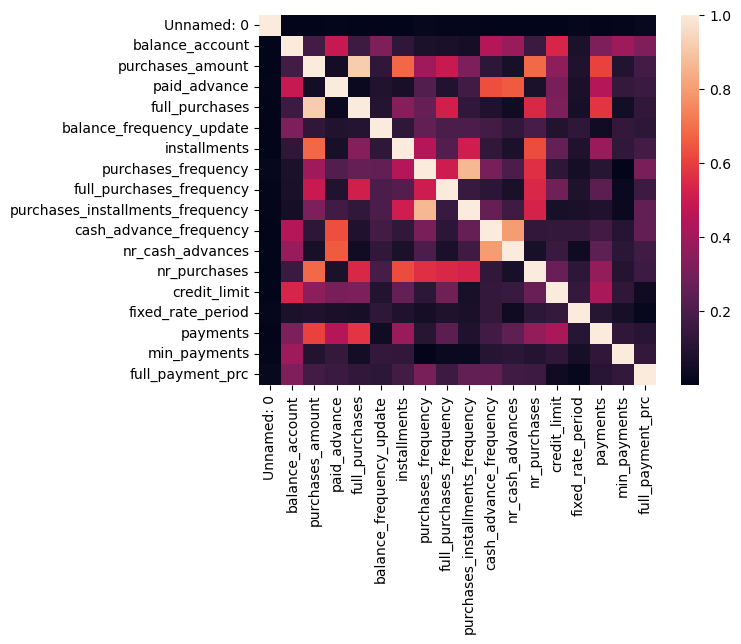

In [5]:
# Create correlation matrixs
corr_matrix = df_num.corr().abs()

sns.heatmap(corr_matrix);



In [17]:
from pyod.models import cblof

cblof_model = cblof.CBLOF(contamination=0.01, random_state=42)
cblof_model.fit(df_num)

CBLOF(alpha=0.9, beta=5, check_estimator=False, clustering_estimator=None,
   contamination=0.01, n_clusters=8, n_jobs=None, random_state=42,
   use_weights=False)

In [24]:
# put labels to the outliers, 1 is outlier and 0 is no outlier

outlier_predictions = cblof_model.predict(df_num)
outliers_df = df_num.copy(deep=True)
outliers_df['Outlier_cblof'] = outlier_predictions


#outliers_df.to_csv('/Users/mjs/Desktop/Dev/cblof_outliers.csv')

only_outliers_df = outliers_df[outliers_df['Outlier_cblof'] == 1]
print('Total Outliers:', len(outliers_df))
outliers_sorted = outliers_df.sort_values(by=['balance_account', 'purchases_amount'], ascending=False)
outliers_sorted.head(5)

Total Outliers: 8334


,Unnamed: 0,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc,Outlier_cblof
2520,2570,19043.13856,22009.92,0.000000,9449.07,1.0,12560.85,1.0,0.750000,1.000000,0.000000,0,216,18000.0,12,23018.575830,18621.013310,0.0,1
7465,7615,18495.55855,5288.28,0.000000,3657.30,1.0,1630.98,1.0,0.583333,1.000000,0.000000,0,76,22000.0,12,4246.168346,4227.081580,0.0,0
2861,2917,16304.88925,1770.57,7424.094447,0.00,1.0,1770.57,0.5,0.000000,0.416667,0.666667,13,9,19000.0,12,5337.961195,8345.641905,0.0,0
6490,6619,16259.44857,5024.68,328.698275,3582.45,1.0,1442.23,1.0,0.833333,1.000000,0.083333,2,143,18000.0,12,4987.235359,5137.504664,0.0,0
1286,1312,16115.59640,684.74,4354.002428,105.30,1.0,579.44,1.0,0.083333,1.000000,0.583333,15,15,18000.0,12,3546.061550,5743.736444,0.0,0


In [28]:
#List of only the outliers

only_outliers_df = outliers_df[outliers_df['Outlier_cblof'] == 1]
print('Total Outliers:', len(only_outliers_df))
outliers_sorted = only_outliers_df.sort_values(by=['balance_account', 'purchases_amount'], ascending=False)
outliers_sorted.head()

Total Outliers: 84


,Unnamed: 0,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc,Outlier_cblof
2520,2570,19043.13856,22009.92,0.000000,9449.07,1.0,12560.85,1.0,0.75,1.000000,0.000000,0,216,18000.0,12,23018.57583,18621.013310,0.000000,1
3456,3528,14581.45914,0.00,22665.778500,0.00,1.0,0.00,0.0,0.00,0.000000,0.833333,30,0,18500.0,12,20941.32551,5433.759888,0.000000,1
3255,3319,14100.25110,4995.80,20712.670080,3403.11,1.0,1592.69,1.0,1.00,0.333333,0.833333,36,34,16500.0,12,20418.33238,21235.065300,0.000000,1
6959,7099,13763.47358,9670.84,1896.204934,6701.08,1.0,2969.76,1.0,0.75,1.000000,0.166667,2,88,17500.0,12,24199.11108,3039.137305,0.083333,1
6594,6725,13673.07961,9792.23,2444.445738,3959.81,1.0,5832.42,1.0,0.75,1.000000,0.750000,26,216,20000.0,12,11717.30794,6042.391629,0.000000,1


In [34]:
columns = list(df.columns)
columns_n = columns[1:]

In [6]:
import plotly as py
import plotly.graph_objs as go

import warnings
warnings.filterwarnings('ignore')

from sklearn import preprocessing 
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering 

In [ ]:
plt.figure(1, figsize = (16 ,8))
dendrogram = sch.dendrogram(sch.linkage(df_num, method  = "ward", optimal_ordering = True))

plt.title('Dendrogram')
plt.xlabel('Customers')
plt.ylabel('Euclidean distances')
plt.show()

In [11]:
# Add the clusters according to hierarchial clustering, with 3 and 9 clusters

from sklearn.cluster import AgglomerativeClustering

clustering_model3 = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage='ward')
clustering_model3.fit(df_num)
labels_hierarchical_3c = clustering_model3.labels_

clustering_model9 = AgglomerativeClustering(n_clusters=9, affinity='euclidean', linkage='ward')
clustering_model9.fit(df_num)
labels_hierarchical_9c = clustering_model9.labels_

In [13]:
#Code to add the cluster to the df

df_num['labels_hierarchical_3c'] = labels_hierarchical_3c

df_num['labels_hierarchical_9c'] = labels_hierarchical_9c

df_num

,Unnamed: 0,balance_account,purchases_amount,paid_advance,full_purchases,balance_frequency_update,installments,purchases_frequency,full_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,nr_cash_advances,nr_purchases,credit_limit,fixed_rate_period,payments,min_payments,full_payment_prc,labels_hierarchical_3c,labels_hierarchical_9c
0,0,9.298409,107.60,0.000000,0.00,0.909091,107.60,0.909091,0.000000,0.818182,0.000000,0,10,1000.0,11,89.868853,89.711672,0.428571,0,4
1,1,52.666422,150.30,0.000000,0.00,1.000000,150.30,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,6,54.722514,82.955180,0.000000,0,4
2,2,1360.795674,0.00,462.861443,0.00,1.000000,0.00,0.000000,0.000000,0.000000,0.272727,6,0,1500.0,11,303.031979,443.781316,0.000000,0,4
3,3,2021.641161,363.18,0.000000,363.18,1.000000,0.00,1.000000,1.000000,0.000000,0.000000,0,13,2000.0,12,704.240770,795.859808,0.000000,0,4
4,4,22.322374,95.00,1162.045833,95.00,0.363636,0.00,0.083333,0.083333,0.000000,0.166667,3,1,2500.0,12,4094.261427,40.142262,0.000000,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8329,8495,1127.607606,0.00,271.093275,0.00,1.000000,0.00,0.000000,0.000000,0.000000,0.083333,1,0,8500.0,12,662.387331,260.277533,0.000000,0,2
8330,8496,21.409828,149.71,0.000000,0.00,1.000000,149.71,0.916667,0.000000,0.916667,0.000000,0,11,1500.0,12,141.974905,150.500248,0.166667,0,6
8331,8497,0.000000,0.00,253.887233,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.111111,1,0,500.0,9,2437.932505,0.000000,0.000000,0,6
8332,8498,1646.384530,1047.34,146.650389,1047.34,1.000000,0.00,0.583333,0.583333,0.000000,0.166667,2,51,3000.0,12,462.848132,497.408854,0.000000,0,6


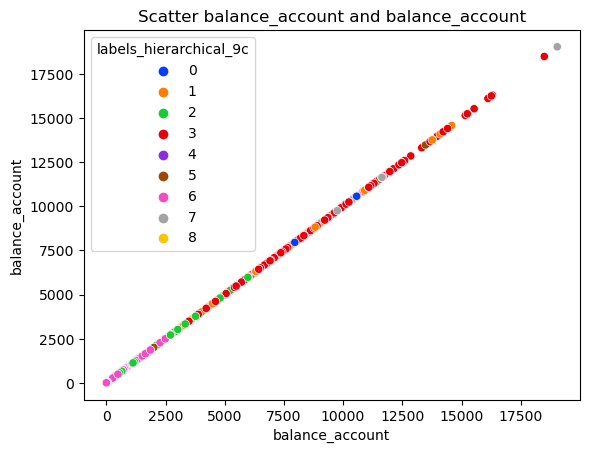

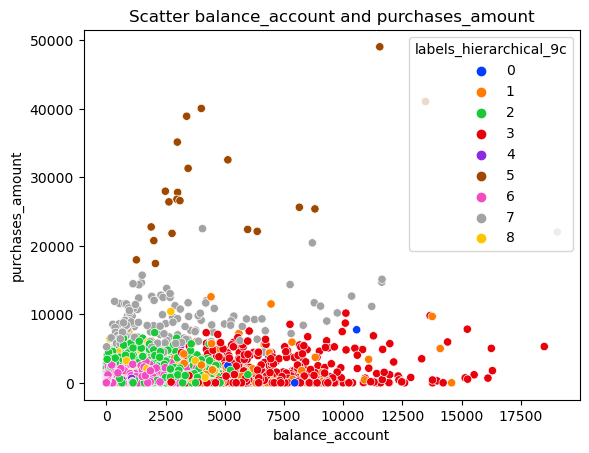

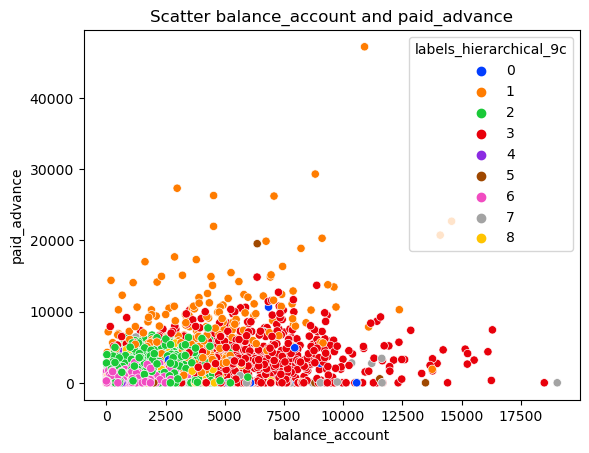

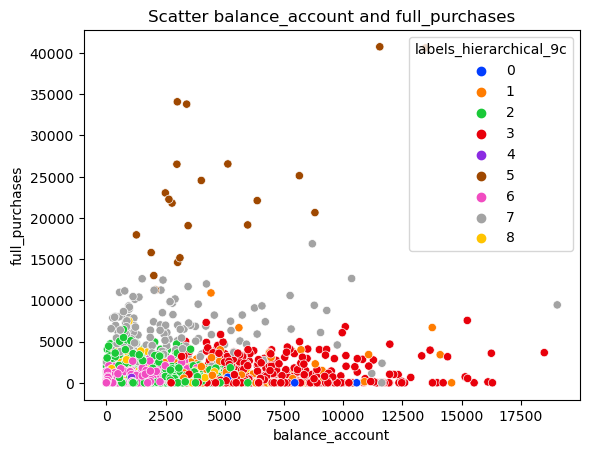

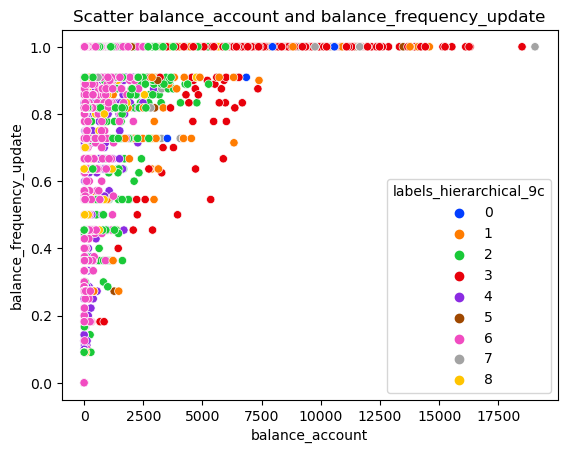

...

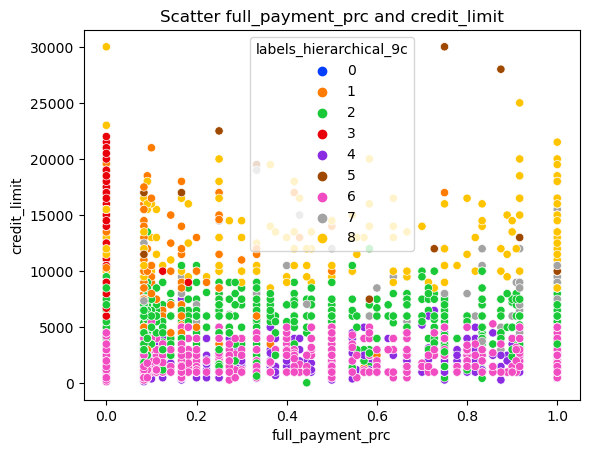

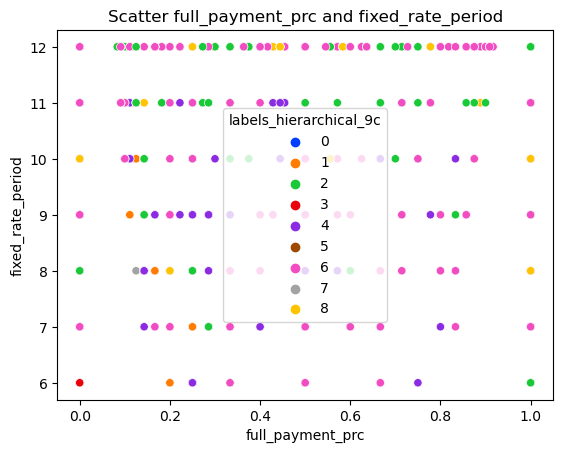

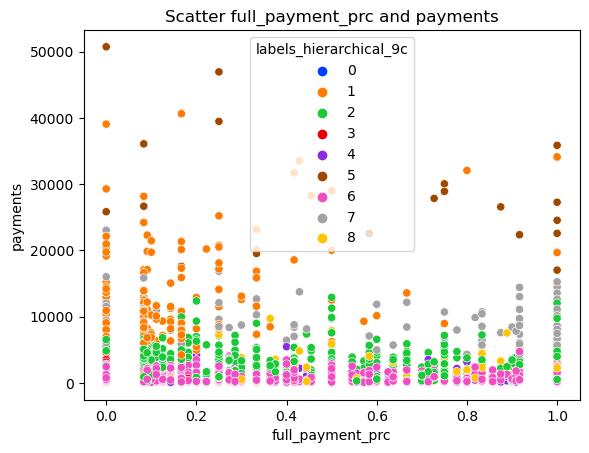

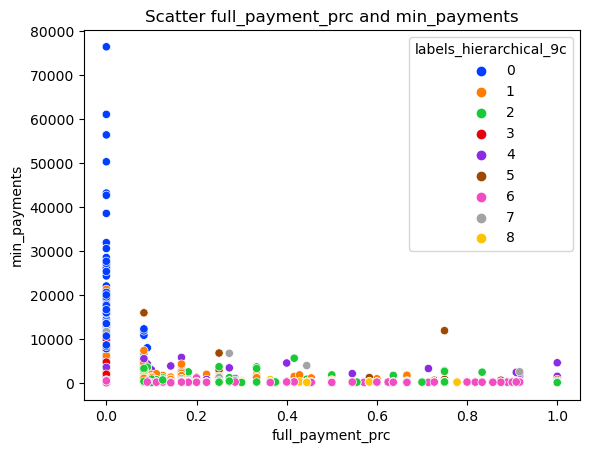

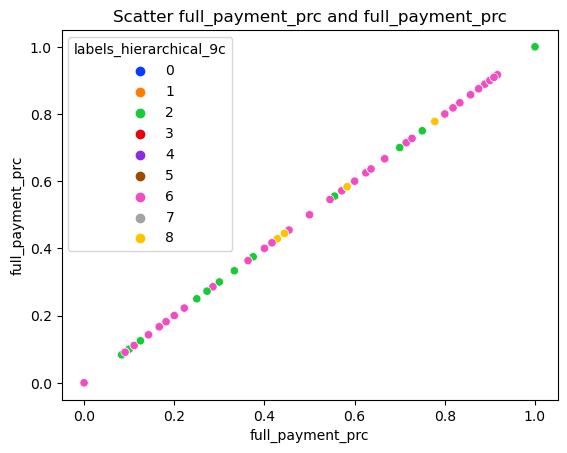

In [34]:
col = list(df_num.columns[1:-2])
col


#fig, axes = plt.subplots(17,17,figsize=(20,20))

for i, col1 in enumerate (col):
    for j, col2 in enumerate (col):
        sns.scatterplot(x=col1,
            
                y=col2,
                data=df_num, 
                hue=df_num['labels_hierarchical_9c'],
               palette = "bright").set_title(f'Scatter {col1} and {col2}')
        plt.show()
        plt.close()
        

In [ ]:
fig, axes = plt.subplots(17,17,figsize=(20,20))

for i, col1 in enumerate (col):
    for j, col2 in enumerate (col):
        sns.scatterplot(x=col1,
            
                y=col2,
                data=df_num, 
                hue=df_num['labels_hierarchical_3c'],
               palette = "bright").set_title(f'Scatter {col1} and {col2}')

Text(0.5, 1.0, 'Labeled Customer Data')

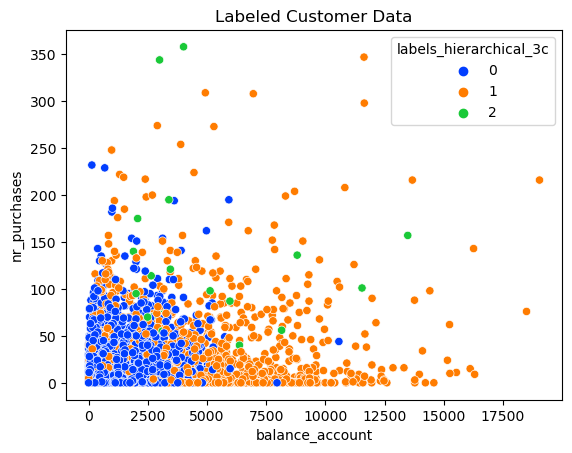

In [20]:
sns.scatterplot(x='balance_account', 
                y='nr_purchases', 
                data=df_num, 
                hue=df_num['labels_hierarchical_3c'],
               palette = "bright").set_title('Labeled Customer Data')

Text(0.5, 1.0, 'Labeled Customer Data')

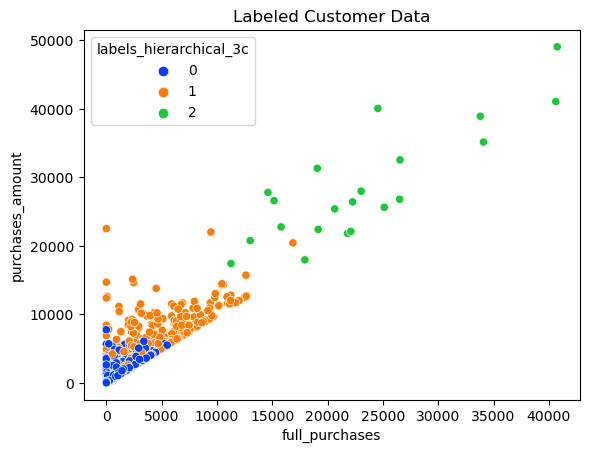

In [33]:
sns.scatterplot(x='full_purchases', 
                y='purchases_amount', 
                data=df_num, 
                hue=df_num['labels_hierarchical_3c'],palette = "bright").set_title('Labeled Customer Data')